In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec


import torch
import torchvision
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F

from sklearn import preprocessing
from skimage import data, color, img_as_float
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.kernel_approximation import RBFSampler

import os
import requests
import warnings

os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
%config InlineBackend.figure_format = 'retina'
%matplotlib inline


In [ ]:
import torchvision
img = torchvision.io.read_image("/content/dog.jpg").float()
print(img.shape)

torch.Size([3, 1365, 2048])


In [ ]:
img = img.clone().detach().float()
# img = torch.tensor(img, dtype=torch.float)

->torch.tensor(img): This converts img, which is likely a NumPy array or a list, into a PyTorch tensor. Tensors are PyTorch's core data structure, similar to NumPy arrays but with additional functionality, like GPU acceleration.

->dtype=torch.float: This ensures that the data type of the tensor is float32. Images are often represented as integers (for example, pixel values from 0 to 255), but for many mathematical operations (like taking the mean), it's better to work with floating-point numbers.

In [ ]:
img.shape

torch.Size([3, 1365, 2048])

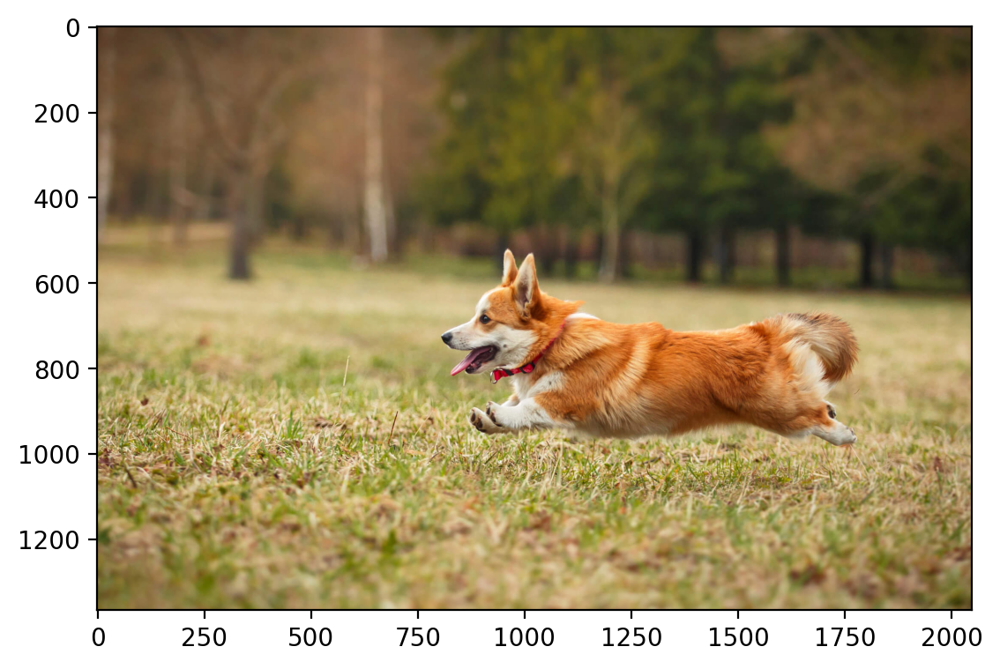

In [ ]:
plt.imshow(img.permute(1, 2, 0) / 255)

In [ ]:
crop_img = torchvision.transforms.functional.crop(img, 600, 800, 300, 300)
crop_img.shape

torch.Size([3, 300, 300])

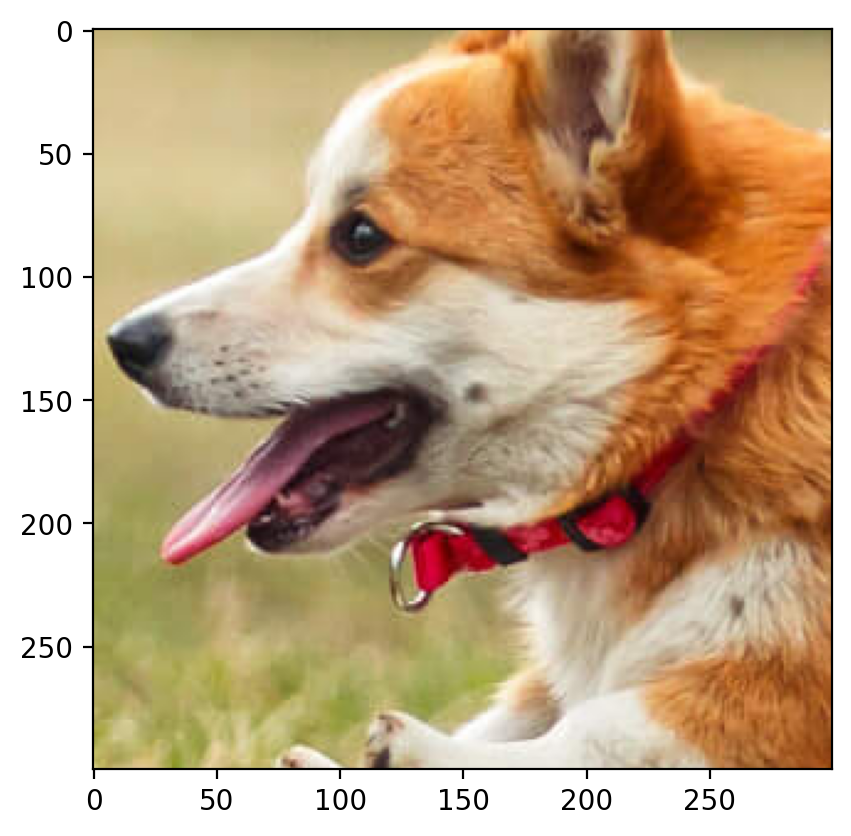

In [ ]:
plt.imshow(crop_img.permute(1, 2, 0) / 255)

TASK-4 [Part - I]

/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


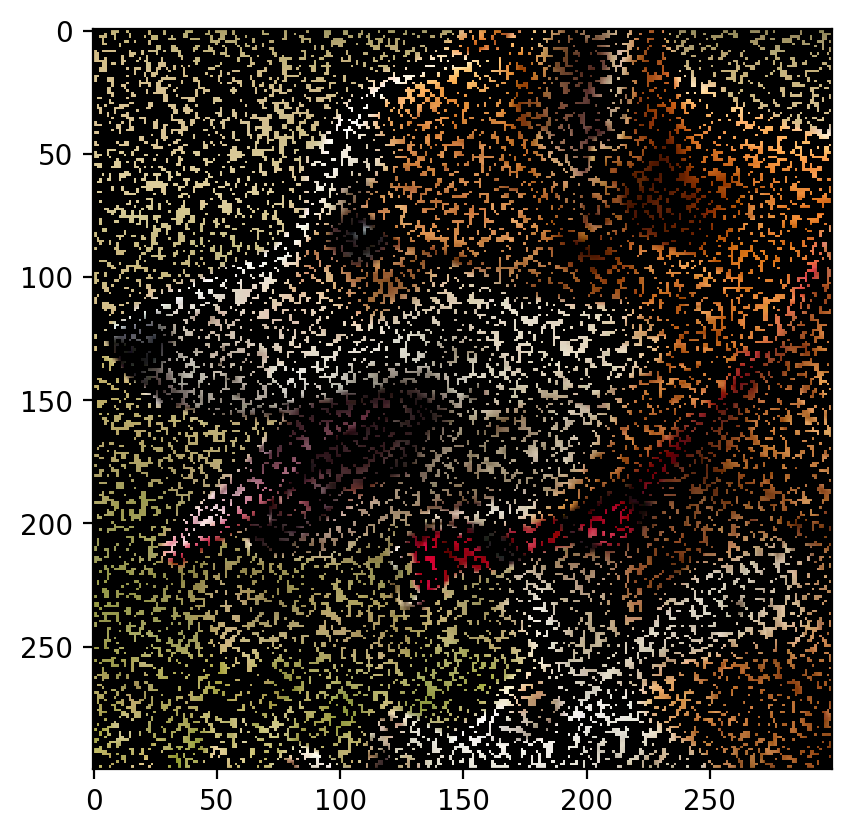

In [ ]:
# Mask the image with NaN values

# mask = torch.rand(img.shape) < prop
def mask_image(img, prop):
    img_copy = img.clone()
    mask = torch.rand(img.shape[1:]) < prop  # Apply mask across spatial dimensions
    img_copy[:, mask] = float('nan')         # Apply NaN mask on all channels
    return img_copy, mask

masked_img, mask = mask_image(crop_img, 0.3)
plt.imshow(masked_img.permute(1, 2, 0) / 255)


In [ ]:
def factorize(A, k, epsilon = 0.001, device=torch.device("cpu")):
    """Factorize the matrix D into A and B"""
    A = A.to(device)

    W = torch.randn(A.shape[0], A.shape[1], k, requires_grad=True, device=device)
    H = torch.randn(A.shape[0], k, A.shape[2], requires_grad=True, device=device)

    #Optimizer
    optimizer = optim.Adam([W, H], lr=0.01)
    mask = ~torch.isnan(A)
    e = 0      #epoch
    while True:
      # Compute the loss
        diff_matrix = torch.matmul(W, H) - A
        diff_vector = diff_matrix[mask]
        loss = torch.norm(diff_vector)

        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

        e = e+1
        if e>1:   # for check
            if prev_loss-loss < epsilon:
                break

        prev_loss = loss
    return W, H, loss

tensor(1712.8826, grad_fn=<LinalgVectorNormBackward0>)


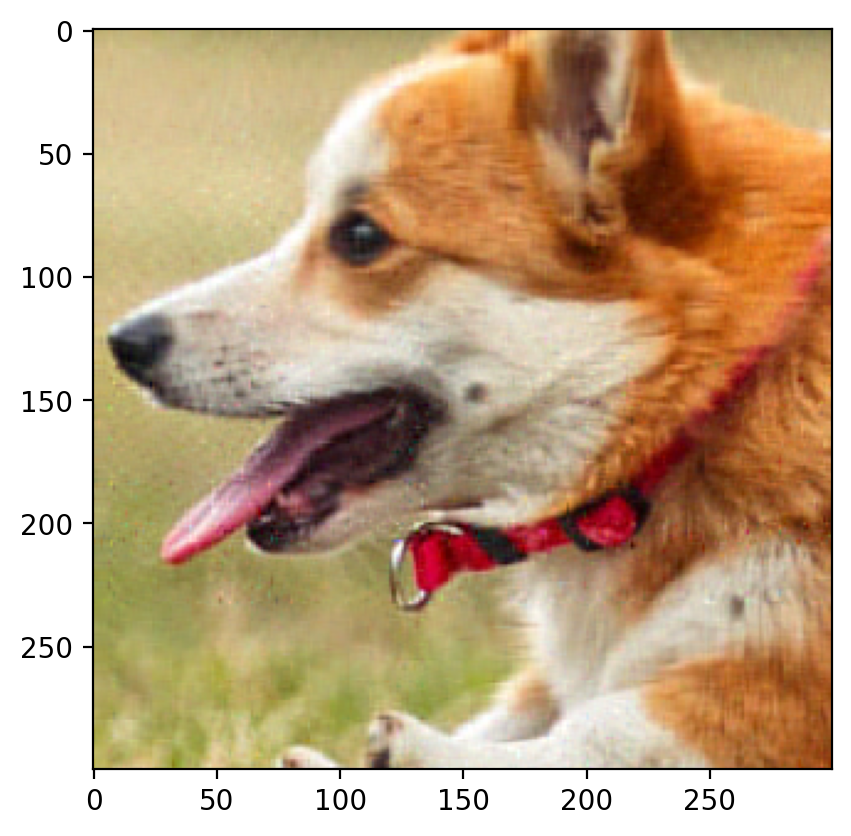

In [ ]:
W, H, loss = factorize(masked_img, 50,device=device)
print(loss)
plt.imshow(torch.matmul(W, H).cpu().detach().permute(1, 2, 0) / 255)

tensor(487.6218, grad_fn=<LinalgVectorNormBackward0>)


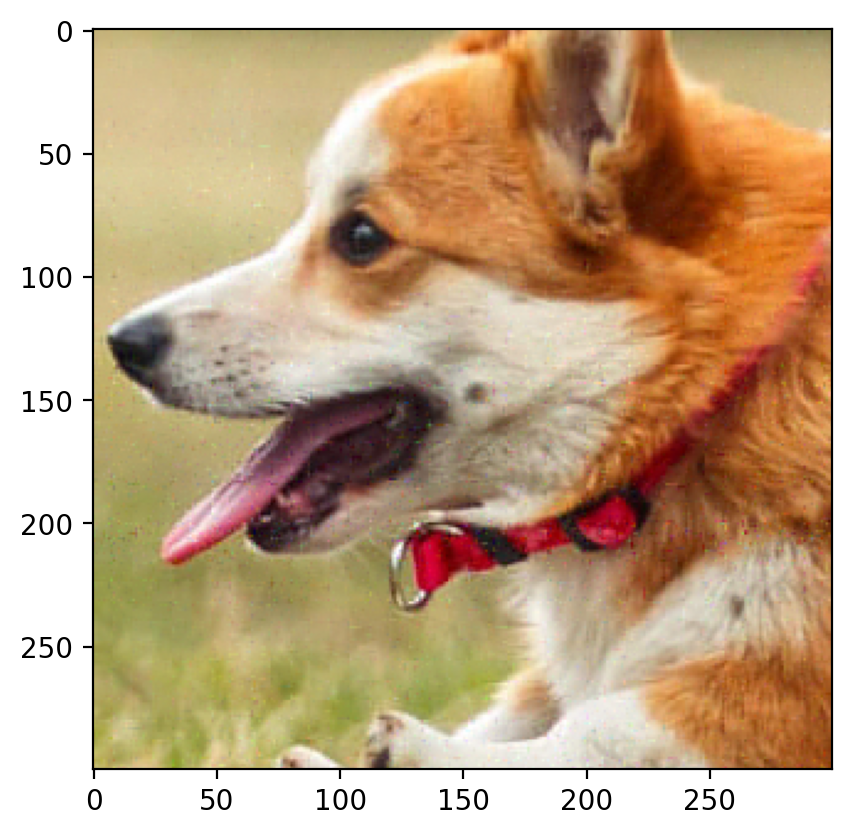

In [ ]:
W, H, loss = factorize(masked_img, 100,device=device)
print(loss)
plt.imshow(torch.matmul(W, H).cpu().detach().permute(1, 2, 0) / 255)

tensor(345.7289, grad_fn=<LinalgVectorNormBackward0>)


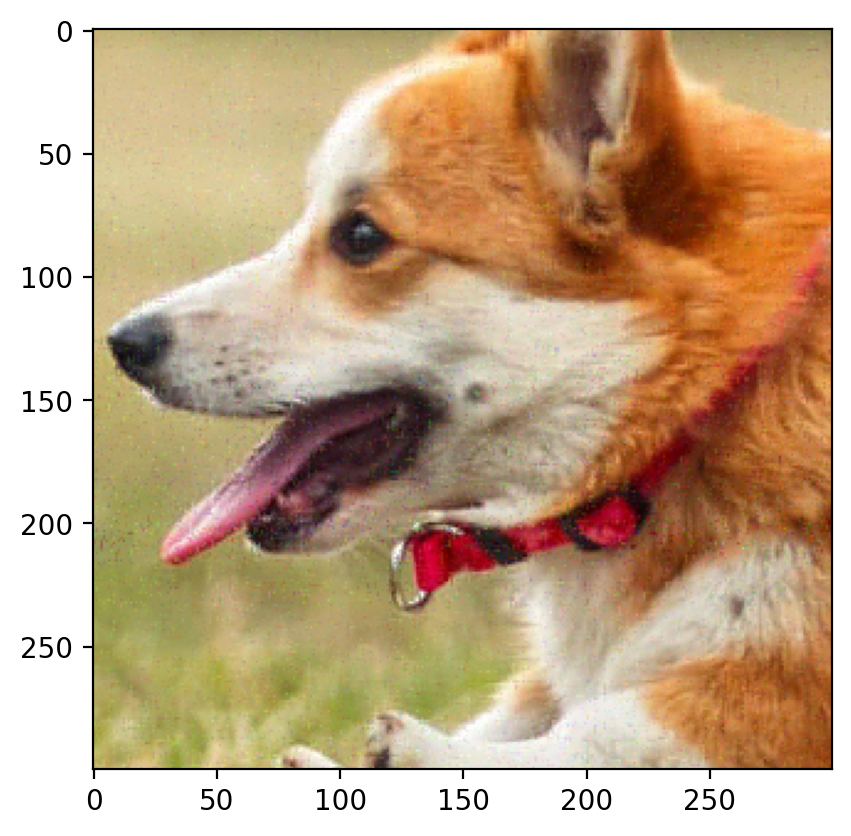

In [ ]:
W, H, loss = factorize(masked_img, 150,device=device)
print(loss)
plt.imshow(torch.matmul(W, H).cpu().detach().permute(1, 2, 0) / 255)

tensor(285.8156, grad_fn=<LinalgVectorNormBackward0>)


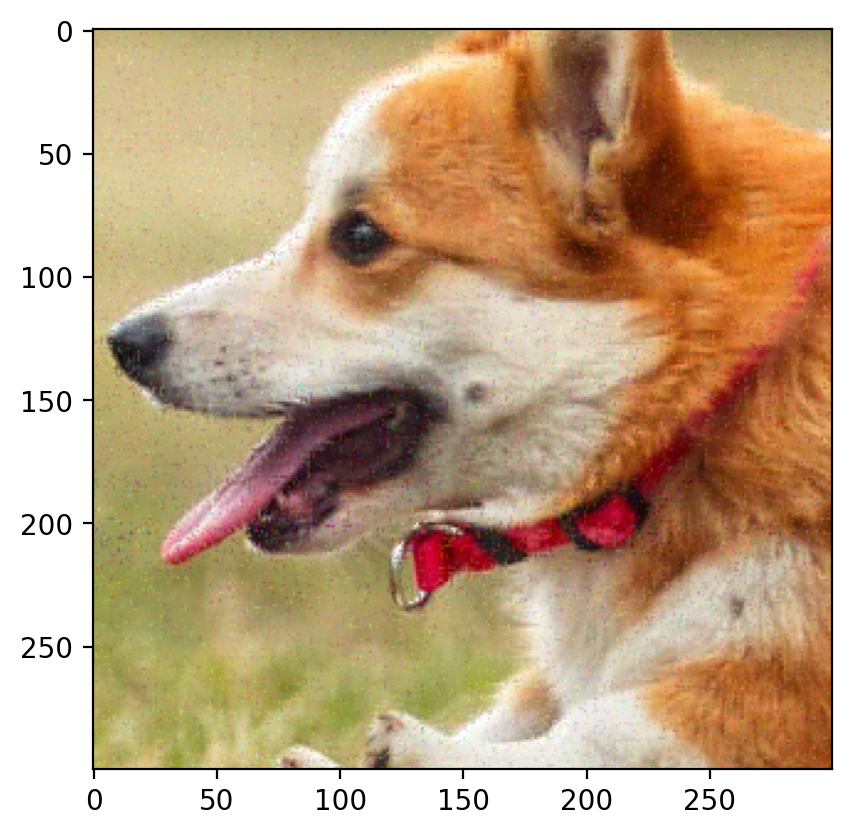

In [ ]:
W, H, loss = factorize(masked_img, 200,device=device)
print(loss)
plt.imshow(torch.matmul(W, H).cpu().detach().permute(1, 2, 0) / 255)

In [ ]:
def reconstruct_img(masked_image,factors=50,device=torch.device("cpu")):
    W, H, loss = factorize(masked_image,factors,device=device)
    reconstruct_img = torch.matmul(W, H).cpu().detach()
    reconstruct_img = torch.clamp(reconstruct_img, 0, 255)
    return reconstruct_img

In [ ]:
def compute_rmse(tensor1, tensor2):
    # Ensure both tensors are on the same device (GPU)
    assert tensor1.shape == tensor2.shape, "Tensors must have the same shape"

    mse = torch.mean((tensor1 - tensor2) ** 2)
    rmse = torch.sqrt(mse)
    return rmse.item()

def compute_psnr(tensor1, tensor2, max_pixel_value=1.0):
    mse = torch.mean((tensor1 - tensor2) ** 2)
    psnr = 10 * torch.log10(max_pixel_value ** 2 / mse)
    return psnr.item()


def plot_image_completion(prop, factors):

    masked_img, mask = mask_image(crop_img, prop)
    reconstructed_img = reconstruct_img(masked_img, factors)

    print(f'For Reconstructed and Original Images with prop: {prop}, factors: {factors}')
    print(f'RMSE: {compute_rmse(reconstructed_img, crop_img)} and PSNR: {compute_psnr(reconstructed_img, crop_img)}')
    print("\n")

    mask_3d = mask.unsqueeze(0).repeat(3, 1, 1)  # Make mask match the RGB dimensions (C, H, W)
    print(f'For Reconstructed and Masked Images with prop: {prop}, factors: {factors}')
    print(f'RMSE: {compute_rmse(reconstructed_img[~mask_3d], masked_img[~mask_3d])} and PSNR: {compute_psnr(reconstructed_img[~mask_3d], masked_img[~mask_3d])}')
    print("\n")

    # reconstructed_img = reconstructed_img.numpy()

    #Plot the masked, original, and reconstructed images
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    ax[0].imshow(masked_img.permute(1, 2, 0) / 255)
    ax[0].set_title("Masked image")
    ax[1].imshow(crop_img.permute(1, 2, 0) / 255)
    ax[1].set_title("Original image")
    ax[2].imshow(reconstructed_img.permute(1, 2, 0) / 255)
    ax[2].set_title("Reconstructed image")

    fig.suptitle(f'prop: {prop}, factors: {factors}')          #for common title
    plt.show()

For Reconstructed and Original Images with prop: 0.1, factors: 50
RMSE: 4.72901725769043 and PSNR: -13.495417594909668


For Reconstructed and Masked Images with prop: 0.1, factors: 50
RMSE: 4.375716686248779 and PSNR: -12.820982933044434




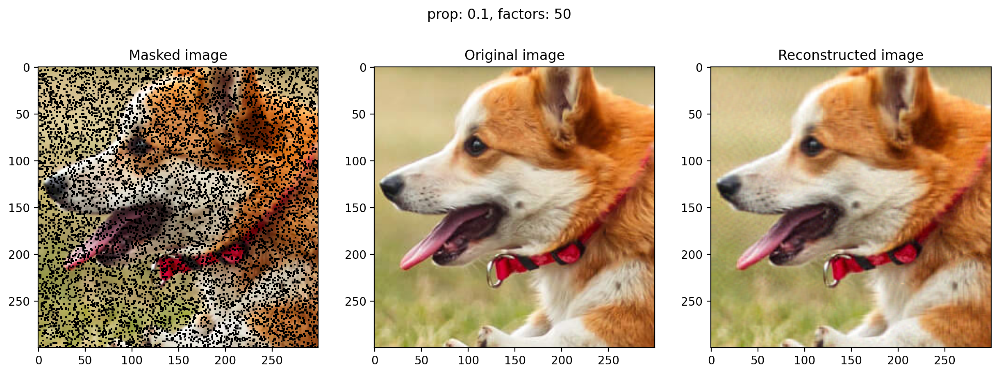

For Reconstructed and Original Images with prop: 0.1, factors: 100
RMSE: 2.154569149017334 and PSNR: -6.667208671569824


For Reconstructed and Masked Images with prop: 0.1, factors: 100
RMSE: 1.4317153692245483 and PSNR: -3.117133378982544




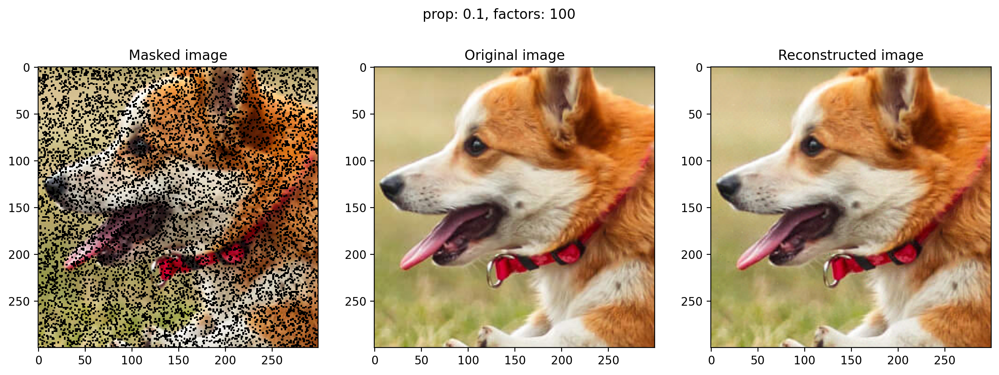

For Reconstructed and Original Images with prop: 0.1, factors: 150
RMSE: 2.071713447570801 and PSNR: -6.32659387588501


For Reconstructed and Masked Images with prop: 0.1, factors: 150
RMSE: 0.9519822001457214 and PSNR: 0.4274231195449829




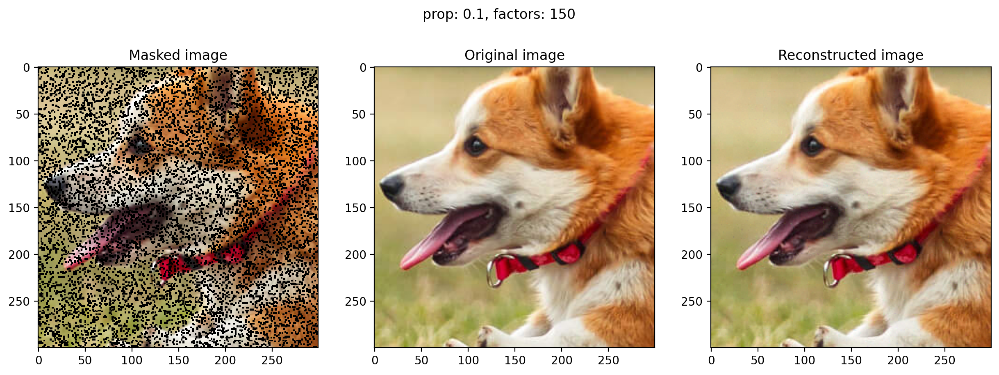

For Reconstructed and Original Images with prop: 0.1, factors: 200
RMSE: 2.7354938983917236 and PSNR: -8.740715026855469


For Reconstructed and Masked Images with prop: 0.1, factors: 200
RMSE: 0.8722214698791504 and PSNR: 1.1874648332595825




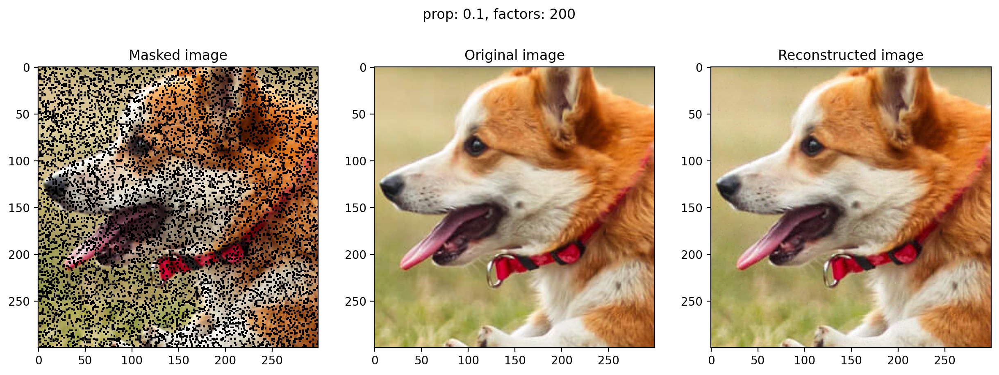

In [ ]:
factors = [50,100,150,200]
for i in factors:
    plot_image_completion(0.1,i)

TASK-4 [Part-II]

Reconstruct image by using matrix factorization

torch.Size([3, 300, 300])


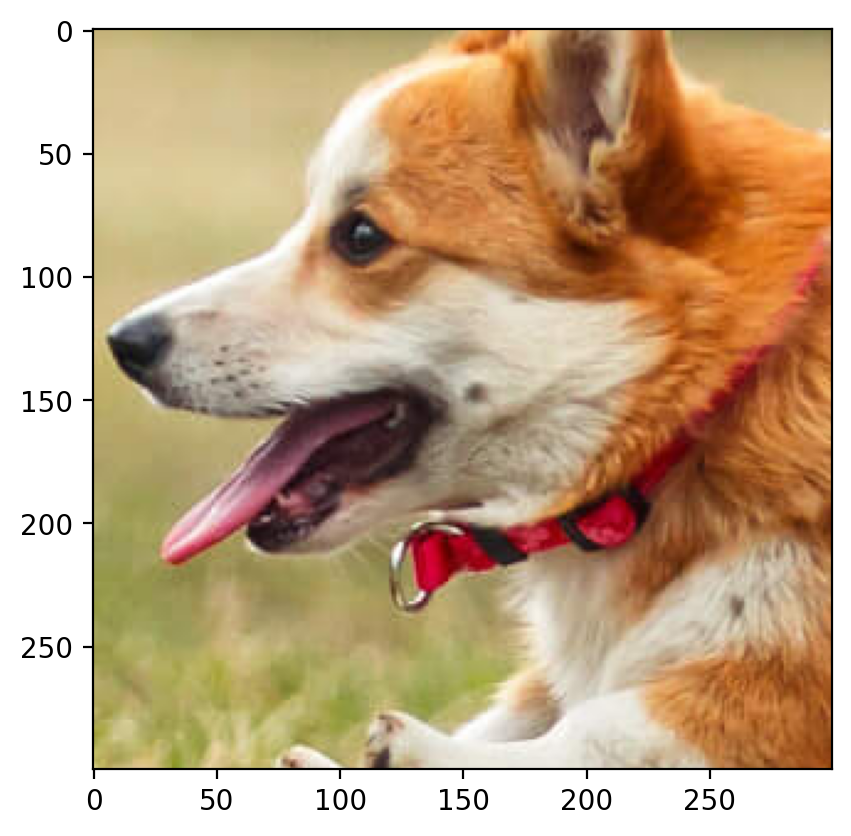

In [ ]:
crop_img2 = torchvision.transforms.functional.crop(img, 600, 800, 300, 300)
print(crop_img2.shape)
plt.imshow(crop_img2.permute(1, 2, 0) / 255)

Masked rows: [128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157]
Masked cols: [86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]




/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


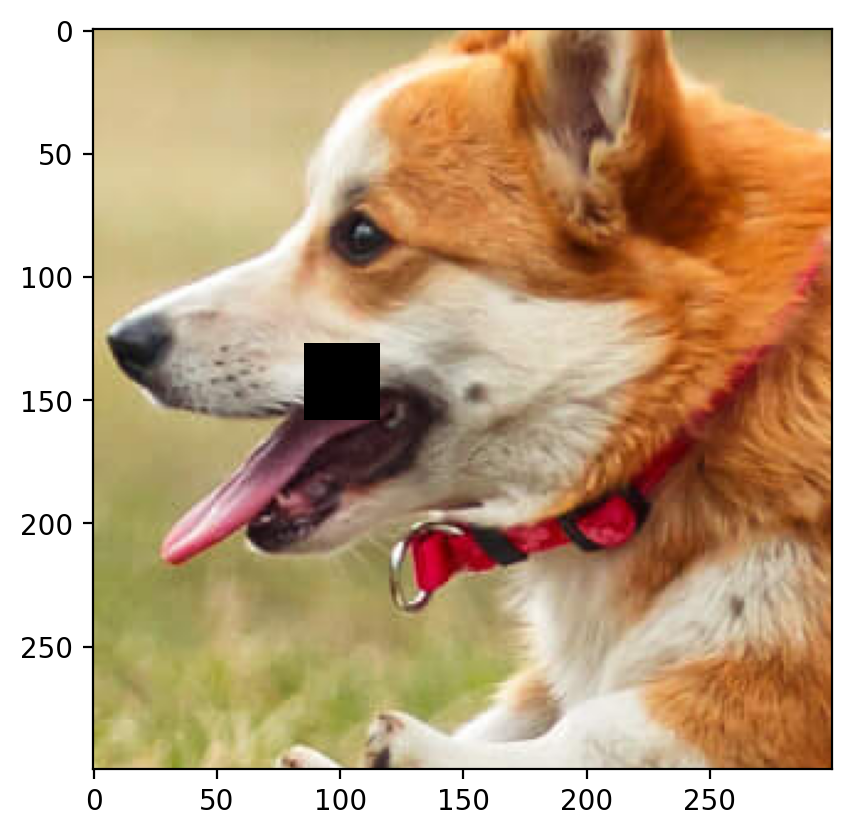

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt

def mask_900_pixel(img):
    img = img.clone()

    tl_x=np.random.randint(0, 269)
    tl_y=np.random.randint(0, 269)

    # Create a 30x30 mask filled with NaN
    mask = np.zeros((30, 30))
    mask[mask == 0] = float('nan')
    mask = torch.from_numpy(mask).float()

    img[:, tl_x:tl_x+30, tl_y:tl_y+30] = mask  #Apply mask across all 3 channels

    #Save the masked rows and columns for observation
    masked_rows=range(tl_x, tl_x+30)
    masked_cols=range(tl_y, tl_y+30)

    return img, masked_rows, masked_cols

mask_900_img, masked_rows, masked_cols = mask_900_pixel(crop_img2)
print(f"Masked rows: {list(masked_rows)}")
print(f"Masked cols: {list(masked_cols)}")
print("\n")

# Convert tensor to numpy for visualization
mask_900_img_np=mask_900_img.numpy()
plt.imshow(mask_900_img.permute(1, 2, 0) / 255)
plt.show()

In [ ]:
def plot_image_reconstructed(masked_image,crop, factors):
    mask = masked_image.isnan()
    reconstructed_img = reconstruct_img(masked_image, factors)
    reconstructed_img = torch.clamp(reconstructed_img, 0, 255)

    print(f'For Reconstructed and Original Images with factors:{factors}')
    print(f'RMSE:{compute_rmse(reconstructed_img,crop)} and PSNR:{compute_psnr(reconstructed_img,crop)}')

    mask_3d = mask[0].unsqueeze(0).repeat(3, 1, 1)  # Ensure mask is 3D for RGB (C, H, W)

    print(f'For Reconstructed and Masked Images with factors: {factors}')
    print(f'RMSE: {compute_rmse(reconstructed_img[~mask_3d], masked_image[~mask_3d])} and PSNR: {compute_psnr(reconstructed_img[~mask_3d], masked_image[~mask_3d])}')

    # reconstructed_img = reconstructed_img.numpy()

    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(masked_image.permute(1, 2, 0) / 255)
    ax[0].set_title("900 pixles removing image")
    ax[1].imshow(crop.permute(1, 2, 0) / 255)
    ax[1].set_title("Original image")
    ax[2].imshow(reconstructed_img.permute(1, 2, 0) / 255)
    ax[2].set_title("Reconstructed image")

    fig.suptitle(f'factors: {factors}')
    plt.show()
    return reconstructed_img

For Reconstructed and Original Images with factors:50
RMSE:9.994379043579102 and PSNR:-19.995115280151367
For Reconstructed and Masked Images with factors: 50
RMSE: 4.3850555419921875 and PSNR: -12.839502334594727


/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


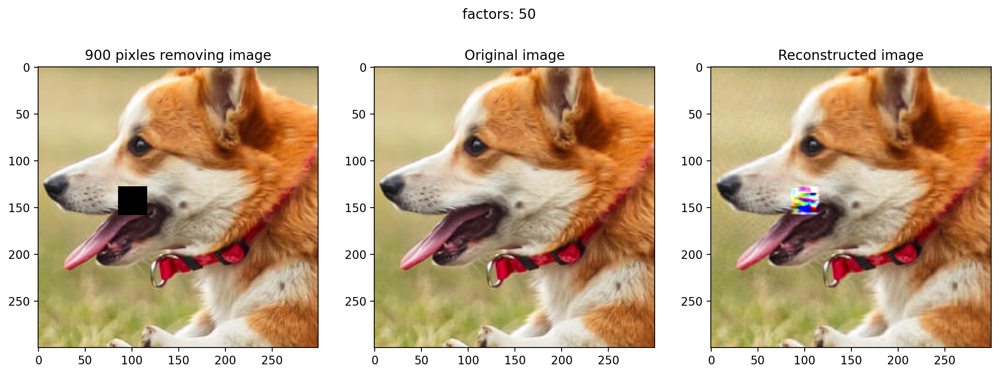

For Reconstructed and Original Images with factors:100
RMSE:5.9843034744262695 and PSNR:-15.540271759033203
For Reconstructed and Masked Images with factors: 100
RMSE: 1.4989988803863525 and PSNR: -3.5160257816314697


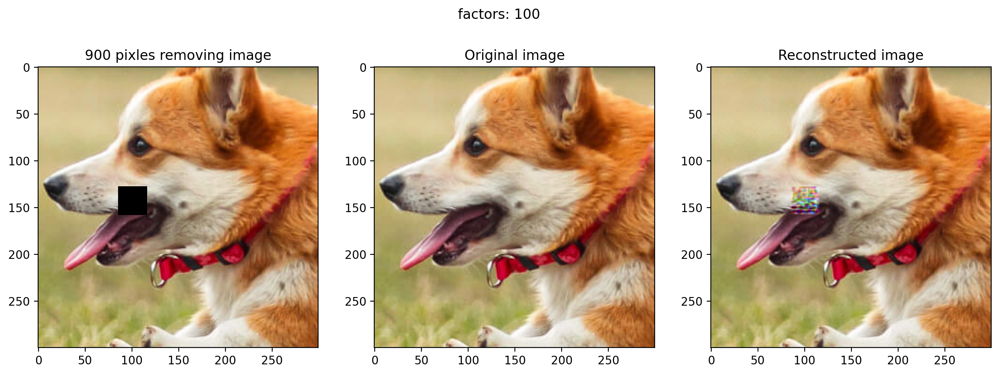

For Reconstructed and Original Images with factors:150
RMSE:4.7171149253845215 and PSNR:-13.473528861999512
For Reconstructed and Masked Images with factors: 150
RMSE: 0.9412777423858643 and PSNR: 0.5256444811820984


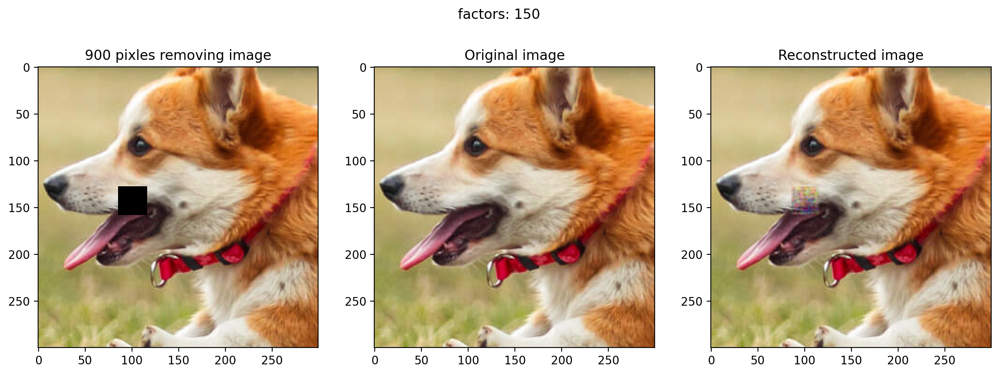

For Reconstructed and Original Images with factors:200
RMSE:5.165200710296631 and PSNR:-14.261743545532227
For Reconstructed and Masked Images with factors: 200
RMSE: 0.8950250744819641 and PSNR: 0.9632961750030518


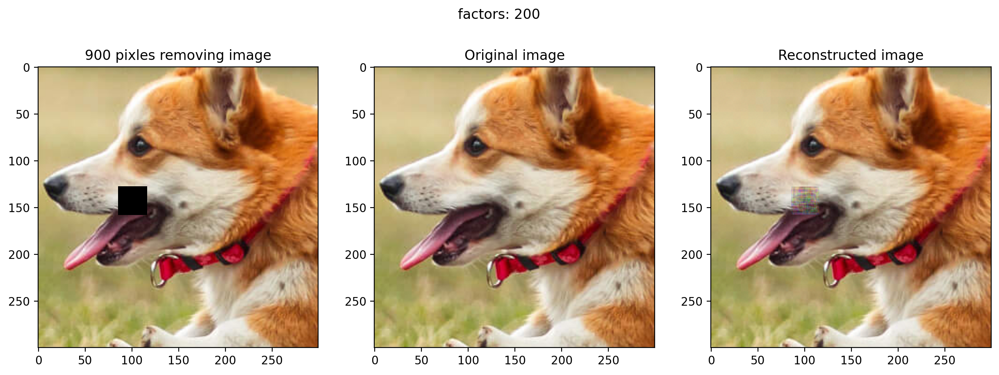

In [ ]:
factors = [50,100,150,200]
for i in factors:
    img = plot_image_reconstructed(mask_900_img, crop_img2, i)
# img=plot_image_reconstructed(mask_900_img, crop_img2, factors=50)

Text(0.5, 1.0, 'Reconstructed image')

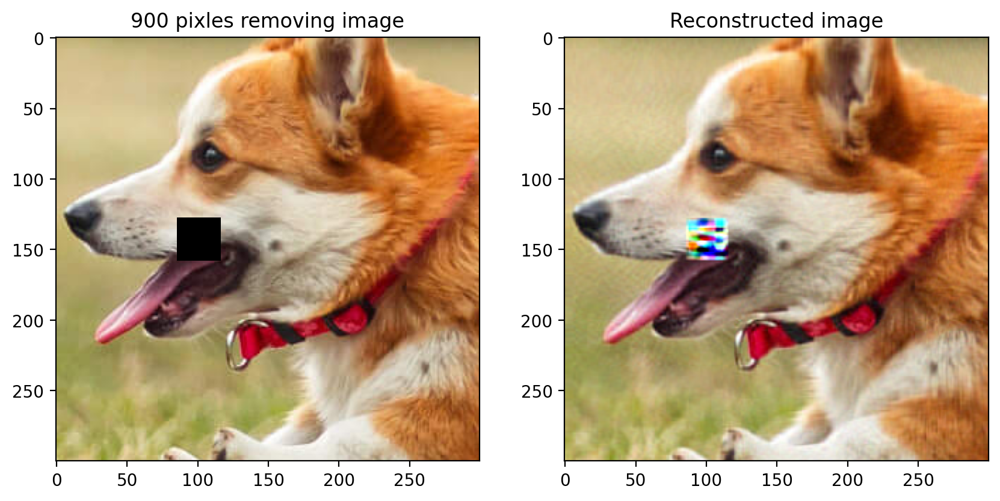

In [ ]:
mf_reconstructed_900_img = reconstruct_img(mask_900_img)
ig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(mask_900_img.permute(1, 2, 0) / 255)
ax[0].set_title("900 pixles removing image")
ax[1].imshow(mf_reconstructed_900_img.permute(1, 2, 0) / 255)
ax[1].set_title("Reconstructed image")

Reconstruct image by using RFF + Linear-regression

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
img=torchvision.io.read_image('/content/dog.jpg').float()/255

torch.Size([3, 300, 300])


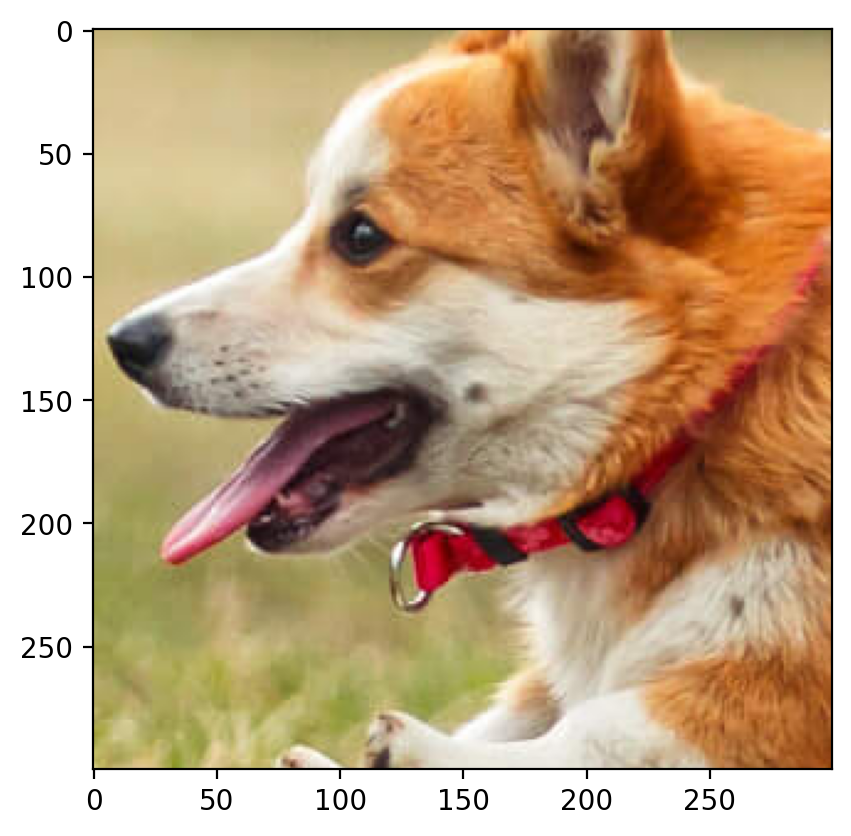

In [ ]:
crop_img2 = torchvision.transforms.functional.crop(img, 600, 800, 300, 300)
print(crop_img2.shape)
plt.imshow(crop_img2.permute(1, 2, 0))
img = crop_img2

In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import Ridge
from sklearn.kernel_approximation import RBFSampler

In [ ]:
img.shape

torch.Size([3, 300, 300])

In [ ]:
img = img.to(device)

#For removing the 900(30,30) pixles from image
def mask_900_pixel(img):
    tl_x=np.random.randint(0, 269)
    tl_y=np.random.randint(0, 269)

    mask = np.ones((300, 300))
    mask[tl_y:tl_y+30, tl_x:tl_x+30] = 0
    return mask,(tl_x,tl_y)

mask_,sq_coord = mask_900_pixel(img.cpu().numpy())
tl_y, tl_x = sq_coord

#apply the mask to the image
mask_img=img.clone()
for i in range(img.shape[0]):
    mask_img[i, :, :] *=torch.tensor(mask_).to(device)


#reconstruct image by using RFF
def reconstruct_by_rff(img, mask, sq_coord,iteration=1000,gamma=0.05):
    """Reconstruct missing pixels using RFF + Linear Regression."""

    tl_y, tl_x = sq_coord
    x=np.argwhere(mask==1)
    x_missing=np.argwhere(mask==0)

    img_flattened = img.reshape(img.shape[0], -1)   #for easy access

    reconstructed_rff_list_for_channel = []

    for i in range(img.shape[0]):
        y = img_flattened[i, x[:, 0] * 300 + x[:, 1]]

        #Apply RFF to known pixel positions
        rbf_feature = RBFSampler(gamma=gamma, n_components=iteration, random_state=1)
        x_transformed = rbf_feature.fit_transform(x)
        x_missing_transformed = rbf_feature.transform(x_missing)

        #Train linear regression
        model = Ridge(alpha=1.0)
        model.fit(x_transformed, y)

        # Predict missing pixel values
        y_missing = model.predict(x_missing_transformed)

        # Reconstruct image
        img_reconstructed = img_flattened[i, :].copy()
        img_reconstructed[x_missing[:, 0] * 300 + x_missing[:, 1]] = y_missing
        reconstructed_rff_list_for_channel.append(img_reconstructed.reshape(300, 300))

    reconstructed_img_rff = np.stack(reconstructed_rff_list_for_channel, axis=0)
    return np.clip(reconstructed_img_rff, 0, 1)

reconstructed_img_rff = reconstruct_by_rff(mask_img.cpu().numpy(),mask_, sq_coord)
reconstructed_img_rff = np.transpose(reconstructed_img_rff, (1, 2, 0))

In [ ]:
def calculate_rmse(original, reconstructed):
    a = (original - reconstructed) ** 2
    mse = np.mean(a)
    rmse = np.sqrt(mse)
    return rmse

def calculate_psnr(original, reconstructed,max_pixel_value = 1.0):
    a = (original - reconstructed) ** 2
    mse = np.mean(a)
    psnr = 10 * np.log10(max_pixel_value ** 2 / mse)
    return psnr

RFF + Linear Regression - RMSE: 0.01981332339346409, PSNR: 34.060853548344674 dB


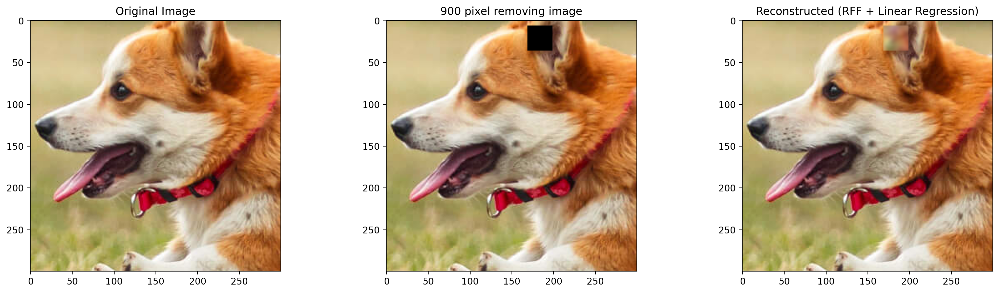

In [ ]:
img = img.cpu().detach().numpy()
img = np.transpose(img, (1, 2, 0))

# Calculate RMSE and PSNR for RFF + Linear Regression
rmse = calculate_rmse(img, reconstructed_img_rff)
psnr = calculate_psnr(img, reconstructed_img_rff)

print(f"RFF + Linear Regression - RMSE: {rmse}, PSNR: {psnr} dB")

# Plot the original, missing, and reconstructed image
fig, ax = plt.subplots(1, 3, figsize=(20, 5))
ax[0].imshow(img)
ax[0].set_title('Original Image')
ax[1].imshow(np.transpose(mask_img.cpu().detach().numpy(), (1, 2, 0)))
ax[1].set_title('900 pixel removing image')
ax[2].imshow(reconstructed_img_rff)
ax[2].set_title('Reconstructed (RFF + Linear Regression)')
plt.show()

RMSE and PSNR value for Matrix Factorization{r = 200}: -

RMSE:5.165200710296631 and PSNR:-14.261743545532227 dB

RMSE and PSNR value for RFF-linear_regression{iteration=1000,gamma=0.05}: -

RMSE: 0.01981332339346409, PSNR: 34.060853548344674 dB

As we know lower RMSE values indicate better accuracy, as RMSE represents the error between the reconstructed and the original image. In this case, RFF-Linear Regression (0.0198) clearly outperforms Matrix Factorization (5.1652), with a much lower error.

or higher PSNR values indicate better reconstruction quality, as PSNR measures the peak signal-to-noise ratio in decibels. RFF-Linear Regression (34.06 dB) also outperforms Matrix Factorization (-14.26 dB), which has a very poor PSNR, even indicating a degradation in the image quality.

So, in conclusion we can say that, RFF-Linear Regression provides a significantly better image reconstruction, with much lower RMSE and higher PSNR values, making it the superior method compared to Matrix Factorization in this case.

Method-II

In [ ]:
crop_img2.shape

torch.Size([3, 300, 300])

In [ ]:
from sklearn import preprocessing
scaler_crop = preprocessing.MinMaxScaler().fit(crop_img2.cpu().reshape(-1, 1))
scaler_crop

MinMaxScaler()

In [ ]:
crop_scaled = scaler_crop.transform(crop_img2.cpu().reshape(-1, 1)).reshape(crop_img2.shape)
print(crop_scaled.shape)

crop_scaled = torch.tensor(crop_scaled)

(3, 300, 300)


In [ ]:
crop_scaled = crop_scaled.to(device)
crop_scaled

tensor([[[0.7686, 0.7686, 0.7686,  ..., 0.5451, 0.5451, 0.5412],
         [0.7725, 0.7725, 0.7725,  ..., 0.5686, 0.5686, 0.5647],
         [0.7765, 0.7765, 0.7765,  ..., 0.5882, 0.5843, 0.5843],
         ...,
         [0.7961, 0.7373, 0.7176,  ..., 0.5843, 0.5725, 0.5490],
         [0.8471, 0.7843, 0.7451,  ..., 0.6039, 0.5686, 0.5569],
         [0.8784, 0.8196, 0.7686,  ..., 0.6275, 0.5804, 0.5686]],

        [[0.6941, 0.6941, 0.6941,  ..., 0.5137, 0.5137, 0.5098],
         [0.6980, 0.6980, 0.6980,  ..., 0.5255, 0.5255, 0.5216],
         [0.7020, 0.7020, 0.7020,  ..., 0.5451, 0.5412, 0.5412],
         ...,
         [0.7686, 0.7098, 0.6863,  ..., 0.2824, 0.2706, 0.2431],
         [0.8157, 0.7569, 0.7137,  ..., 0.3059, 0.2667, 0.2431],
         [0.8431, 0.7882, 0.7333,  ..., 0.3294, 0.2706, 0.2588]],

        [[0.4745, 0.4745, 0.4745,  ..., 0.3294, 0.3294, 0.3255],
         [0.4784, 0.4784, 0.4784,  ..., 0.3451, 0.3451, 0.3412],
         [0.4824, 0.4824, 0.4824,  ..., 0.3647, 0.3608, 0.

In [ ]:
num_channels, height, width = crop_scaled.shape
print(num_channels, height, width)

3 300 300


In [ ]:
num_channels, height, width = 2, 3, 4


# Create a 2D grid of (x,y) coordinates
w_coords = torch.arange(width).repeat(height, 1)
h_coords = torch.arange(height).repeat(width, 1).t()
w_coords = w_coords.reshape(-1)
h_coords = h_coords.reshape(-1)

# Combine the x and y coordinates into a single tensor
X = torch.stack([h_coords, w_coords], dim=1).float()

In [ ]:
def create_coordinate_map(img):
    """
    img: torch.Tensor of shape (num_channels, height, width)

    return: tuple of torch.Tensor of shape (height * width, 2) and torch.Tensor of shape (height * width, num_channels)
    """

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(width).repeat(height, 1)
    h_coords = torch.arange(height).repeat(width, 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Move X to GPU if available
    X = X.to(device)


    # Reshape the image to (h * w, num_channels)
    Y = rearrange(img, 'c h w -> (h w) c').float()
    return X, Y

In [ ]:
!pip install einops

from einops import rearrange


In [ ]:
img_X, img_Y = create_coordinate_map(crop_scaled)
print(img_X.shape)
print(img_Y.shape)

torch.Size([90000, 2])
torch.Size([90000, 3])


In [ ]:
scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(img_X.cpu())
# scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(deer_X)

# Scale the X coordinates
img_X_scaled = scaler_X.transform(img_X.cpu())
# deer_X_scaled = scaler_X.transform(deer_X)

# Move the scaled X coordinates to the GPU
img_X_scaled = torch.tensor(img_X_scaled).to(device)
# deer_X_scaled = torch.tensor(deer_X_scaled)


# Set to dtype float32
img_X_scaled = img_X_scaled.float()

In [ ]:
#training part
def train(net, lr, X, Y, epochs, verbose=True):
    """
    net: torch.nn.Module
    lr: float
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(net.parameters(), lr=lr)
    for epoch in range(epochs):
        optimizer.zero_grad()
        outputs = net(X)


        loss = criterion(outputs, Y)
        loss.backward()
        optimizer.step()
        if verbose and epoch % 100 == 0:
            print(f"Epoch {epoch} loss: {loss.item():.6f}")
    return loss.item()


#Linear regression model

class LinearModel(nn.Module):
    def __init__(self, in_features, out_features):
        super(LinearModel, self).__init__()
        self.linear = nn.Linear(in_features, out_features)

    def forward(self, x):
        return self.linear(x)


def create_rff_features(X, num_features, sigma):
    from sklearn.kernel_approximation import RBFSampler
    rff = RBFSampler(n_components=num_features, gamma=1/(2 * sigma**2))
    X = X.cpu().numpy()
    X = rff.fit_transform(X.reshape(-1, X.shape[-1]))
    return torch.tensor(X, dtype=torch.float32).to(device)

def plot_reconstructed_and_original_image(original_img, net, X, title=""):
    """
    net: torch.nn.Module
    X: torch.Tensor of shape (num_samples, 2)
    Y: torch.Tensor of shape (num_samples, 3)
    """
    num_channels, height, width = original_img.shape
    net.eval()
    with torch.no_grad():
        outputs = net(X)
        outputs = outputs.reshape(height, width, num_channels)
        #outputs = outputs.permute(1, 2, 0)
    fig = plt.figure(figsize=(6, 4))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    ax0.imshow(outputs.cpu())
    ax0.set_title("Reconstructed Image")


    ax1.imshow(original_img.cpu().permute(1, 2, 0))
    ax1.set_title("Original Image")

    for a in [ax0, ax1]:
        a.axis("on")

    fig.suptitle(title, y=0.9)
    plt.tight_layout()

In [ ]:
X_rff = create_rff_features(img_X_scaled, 1000, 0.02)

In [ ]:
net = LinearModel(X_rff.shape[1],3)
net = net.to(device)

In [ ]:
train(net, 0.005, X_rff, img_Y, 300, verbose=True)

Epoch 0 loss: 0.355720
Epoch 100 loss: 0.059309
Epoch 200 loss: 0.026470


0.023426033556461334

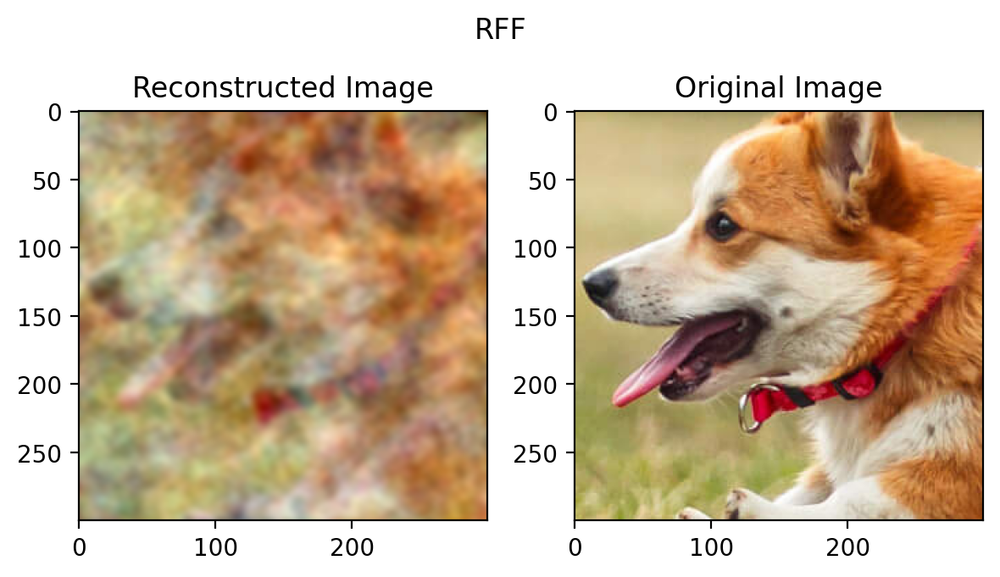

In [ ]:
plot_reconstructed_and_original_image(crop_scaled, net, X_rff, "RFF")

In [ ]:
try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange



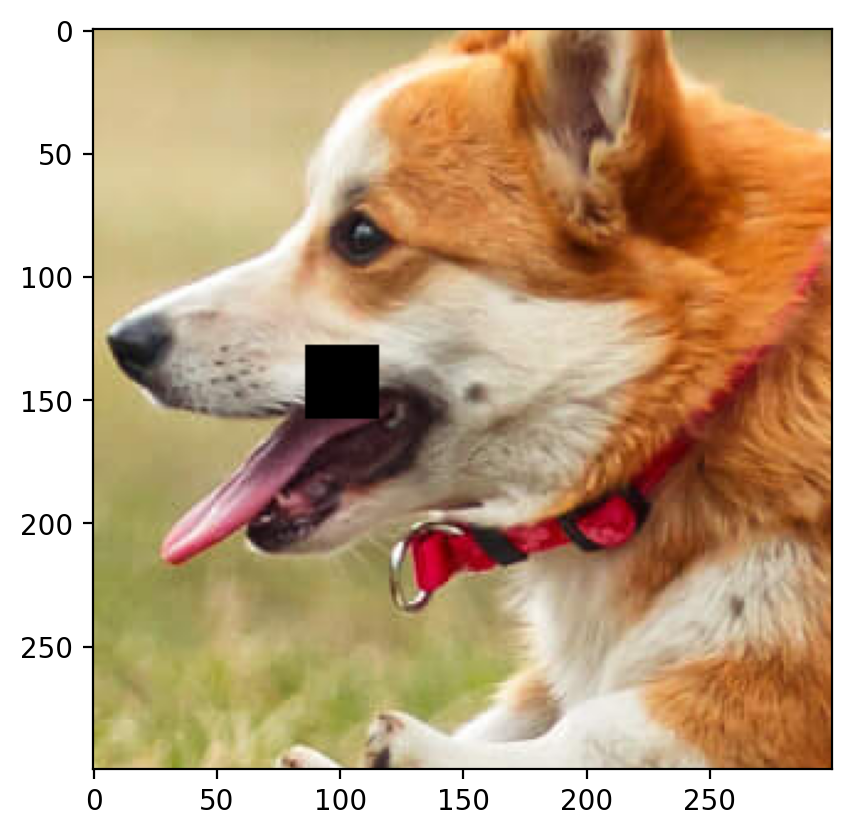

In [ ]:
plt.imshow(mask_900_img.permute(1, 2, 0) / 255)

In [ ]:
rff_image = mask_900_img

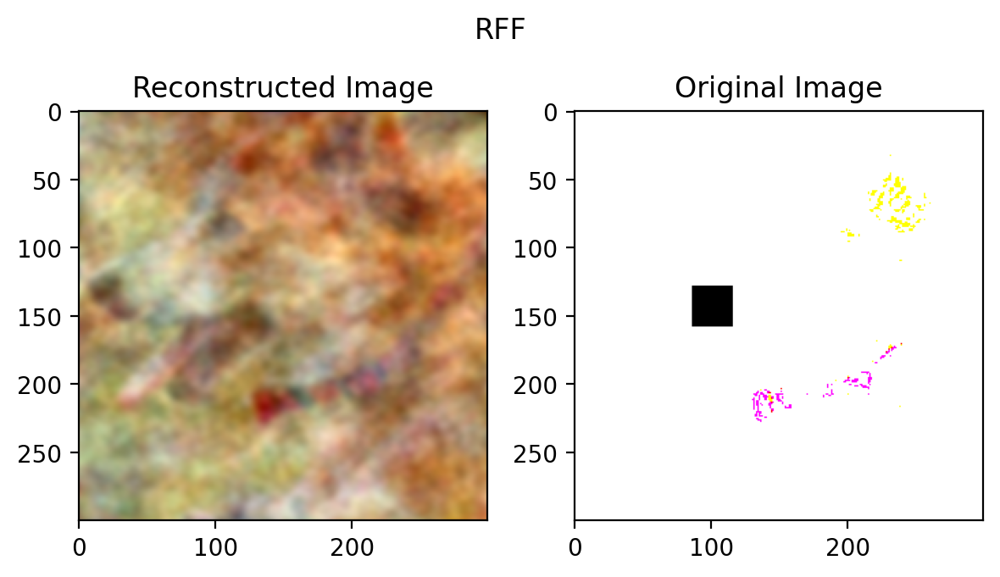

In [ ]:
reconstructed_img = plot_reconstructed_and_original_image(rff_image, net, X_rff, "RFF")

In [ ]:
from sklearn import preprocessing
scaler_r= preprocessing.MinMaxScaler().fit(rff_image.cpu().reshape(-1, 1))
scaler_r

MinMaxScaler()

In [ ]:
scaled_r = scaler_r.transform(rff_image.cpu().reshape(-1, 1)).reshape(rff_image.shape)
scaled_r.shape

scaled_r= torch.tensor(scaled_r)

In [ ]:
scaled_r.shape

torch.Size([3, 300, 300])

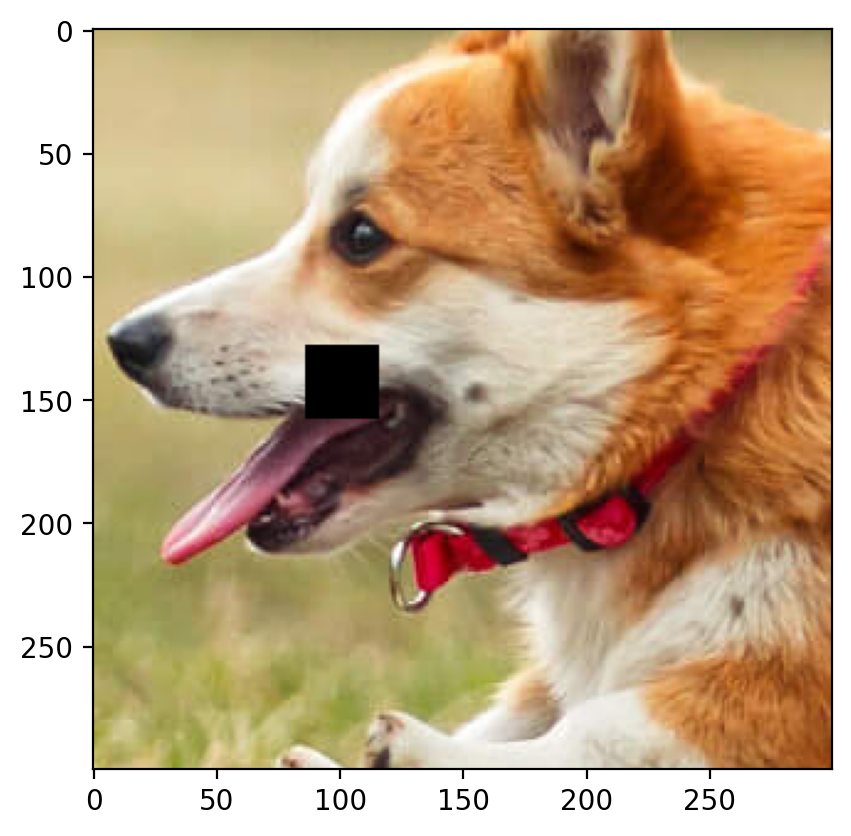

In [ ]:
plt.imshow(scaled_r.permute(1, 2, 0))

In [ ]:
img_X_,img_Y_ = create_coordinate_map(scaled_r)
print(img_X_.shape)
print(img_Y_.shape)

torch.Size([90000, 2])
torch.Size([90000, 3])


In [ ]:
scaler_X_ = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(img_X_.cpu())
# scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(deer_X)

# Scale the X coordinates
img_X_scaled_ = scaler_X_.transform(img_X_.cpu())
# deer_X_scaled = scaler_X.transform(deer_X)

# Move the scaled X coordinates to the GPU
img_X_scaled_ = torch.tensor(img_X_scaled_).to(device)
# deer_X_scaled = torch.tensor(deer_X_scaled)


# Set to dtype float32
img_X_scaled_ = img_X_scaled_.float()

In [ ]:
X_rff_ = create_rff_features(img_X_scaled_,1000,0.02)

In [ ]:
train(net, 0.005, X_rff_, img_Y_, 300, verbose=True)

Epoch 0 loss: 0.071144
Epoch 100 loss: 0.033834
Epoch 200 loss: 0.028982


0.027557488530874252

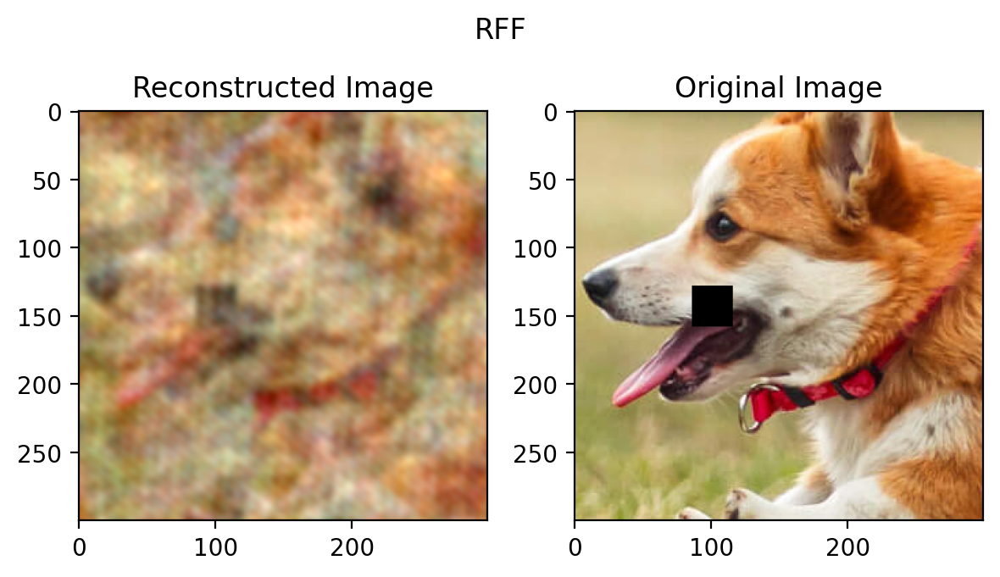

In [ ]:
reconstructed_img_ = plot_reconstructed_and_original_image(scaled_r, net, X_rff_, "RFF")